<a href="https://colab.research.google.com/github/CoderShad/FIN-ADV-AI/blob/main/C10_Word2Vec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A Word2Vec toy example:

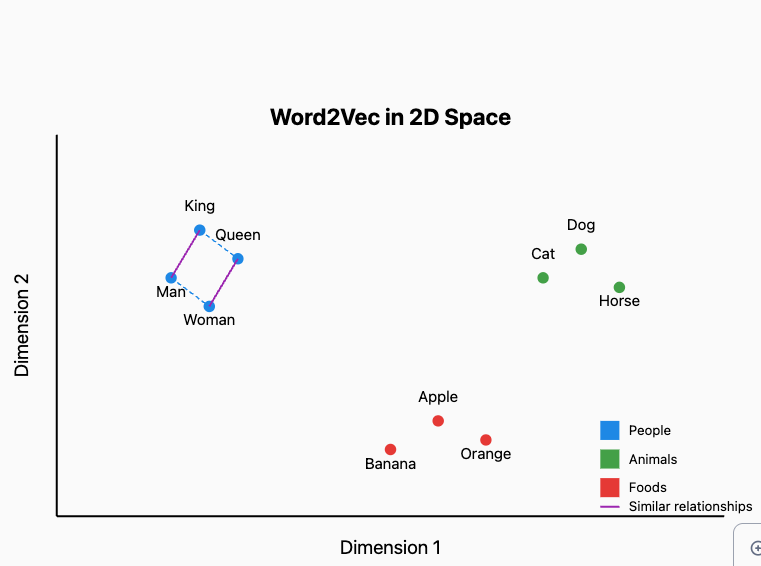

* We discussed in class words could be represented in a vector space
* Lets focus on 2D space - each word (lets say Banana) has X and Y number.
* If the problem we solve is - figure out X and Y for Banana such that we could predict the words that are usuaaly associated with it: delicious, fruit, sweet, etc.
* You will get some X and Y value
* If you solve the same problem for Orange, you will likely get similar X and Y values (as compared to King, where you will get very different X and Y value)

# Getting started with Word2Vec in Gensim and making it work! - NO Run (run time - 20 minutes)

The idea behind Word2Vec is pretty simple. We are making and assumption that you can tell the meaning of a word by the company it keeps. This is analogous to the saying *show me your friends, and I'll tell who you are*. So if you have two words that have very similar neighbors (i.e. the usage context is about the same), then these words are probably quite similar in meaning or are at least highly related. For example, the words `shocked`,`appalled` and `astonished` are typically used in a similar context.

In this tutorial, you will learn how to use the Gensim implementation of Word2Vec and actually get it to work!

### Imports and logging

First, we start with our imports and get logging established:

In [ ]:
## you dont need to run this code, but good to know
## if you do install, click on runtime above and restart session
!pip install gensim

In [ ]:
# imports needed and set up logging
import gzip
import gensim
import logging

logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)


### Dataset
Next, is our dataset. The secret to getting Word2Vec really working for you is to have lots and lots of text data. We will use a smaller dataset that has full user reviews of cars and hotels. Each line in this file represents a hotel review.

To avoid confusion, while gensim’s word2vec tutorial says that you need to pass it a sequence of sentences as its input, you can always pass it a whole review as a sentence (i.e. a much larger size of text), and it should not make much of a difference.

Now, let's take a closer look at this data below by printing the first line. You can see that this is a pretty hefty review.

In [ ]:
import pandas as pd
reviewsdf = pd.read_csv('https://raw.githubusercontent.com/mjha91/data/main/fi8092/reviews.csv')
print(reviewsdf["reviews"].iloc[0])

Oct 12 2009 	Nice trendy hotel location not too bad.	I stayed in this hotel for one night. As this is a fairly new place some of the taxi drivers did not know where it was and/or did not want to drive there. Once I have eventually arrived at the hotel


### Read files into a list
Now that we've had a sneak peak of our dataset, we can read it into a list so that we can pass this on to the Word2Vec model.

I'm also doing a mild pre-processing of the reviews using `gensim.utils.simple_preprocess (line)`. This does some basic pre-processing such as tokenization, lowercasing, etc and returns back a list of tokens (words). Documentation of this pre-processing method can be found on the official [Gensim documentation site](https://radimrehurek.com/gensim/utils.html).


This will take few minutes to finish.

In [ ]:
from gensim.utils import simple_preprocess

# Each review item needs to be a series of words, creating a list of lists - needed for w2v input
# Initialize documents as a list of lists
documents = []

# Process each line in the 'reviews' column
for line in reviewsdf["reviews"]:
    documents.append(simple_preprocess(line))

# Display the processed documents
print(documents)


[['oct', 'nice', 'trendy', 'hotel', 'location', 'not', 'too', 'bad', 'stayed', 'in', 'this', 'hotel', 'for', 'one', 'night', 'as', 'this', 'is', 'fairly', 'new', 'place', 'some', 'of', 'the', 'taxi', 'drivers', 'did', 'not', 'know', 'where', 'it', 'was', 'and', 'or', 'did', 'not', 'want', 'to', 'drive', 'there', 'once', 'have', 'eventually', 'arrived', 'at', 'the', 'hotel'], ['sep', 'great', 'budget', 'hotel', 'stayed', 'two', 'nights', 'at', 'aloft', 'on', 'the', 'most', 'recent', 'trip', 'to', 'china', 'the', 'hotel', 'was', 'very', 'modern', 'and', 'clean', 'the', 'room', 'was', 'spotless', 'and', 'comfortable', 'king', 'sized', 'bed', 'as', 'far', 'as', 'soft', 'beds', 'go', 'in', 'china', 'the', 'staff', 'was', 'very', 'punctual', 'and', 'went', 'out', 'of', 'the', 'way', 'to', 'help', 'my', 'every', 'need'], ['aug', 'excellent', 'value', 'location', 'not', 'big', 'problem', 'we', 'stayed', 'at', 'the', 'aloft', 'beijing', 'haidian', 'for', 'nights', 'from', 'july', 'nd', 'there',

## Training the Word2Vec model

Training the model is fairly straightforward. You just instantiate Word2Vec and pass the reviews that we read in the previous step (the `documents`). So, we are essentially passing on a list of lists. Where each list within the main list contains a set of tokens from a user review. Word2Vec uses all these tokens to internally create a vocabulary. And by vocabulary, I mean a set of unique words.

After building the vocabulary, we just need to call `train(...)` to start training the Word2Vec model. Training on the review dataset takes about 10 minutes so please be patient while running your code on this dataset.

Behind the scenes we are actually training a simple neural network with a single hidden layer. But, we are actually not going to use the neural network after training. Instead, the goal is to learn the weights of the hidden layer. These weights are essentially the word vectors that we’re trying to learn.

* vector_size: The dimensionality of the word vectors.
* window: The maximum distance between the current and predicted word within a sentence.
* min_count: Ignores all words with total frequency lower than this.
* workers: The number of worker threads to train the model.

by default the model is CBOW.

In [ ]:
model = gensim.models.Word2Vec (documents, vector_size=150, window=10, min_count=2, workers=10)
model.train(documents,total_examples=len(documents),epochs=10)

(26381104, 37036230)

## Now, let's look at some output
This first example shows a simple case of looking up words similar to the word `dirty`. All we need to do here is to call the `most_similar` function and provide the word `dirty` as the positive example. This returns the top 10 similar words.

In [ ]:

w1 = "dirty"
model.wv.most_similar (positive=w1)


[('filthy', 0.7839300632476807),
 ('smelly', 0.7580759525299072),
 ('stained', 0.7256283164024353),
 ('dingy', 0.7040384411811829),
 ('nasty', 0.6889762282371521),
 ('gross', 0.6883580088615417),
 ('moldy', 0.6662235856056213),
 ('dusty', 0.6563831567764282),
 ('musty', 0.6457424759864807),
 ('grubby', 0.6438647508621216)]

That looks pretty good, right? Let's look at a few more. Let's look at similarity for `polite`, `france` and `shocked`.

In [ ]:
# look up top 6 words similar to 'polite'
w1 = ["polite"]
model.wv.most_similar (positive=w1,topn=6)


[('courteous', 0.8563576936721802),
 ('friendly', 0.735703706741333),
 ('professional', 0.7345426082611084),
 ('attentive', 0.7118609547615051),
 ('smiley', 0.7000730037689209),
 ('cordial', 0.6995089054107666)]

In [ ]:
# look up top 6 words similar to 'france'
w1 = ["france"]
model.wv.most_similar (positive=w1,topn=6)


[('gaulle', 0.6328566670417786),
 ('california', 0.5682874917984009),
 ('lanka', 0.5611014366149902),
 ('san', 0.5606330633163452),
 ('utah', 0.5600212812423706),
 ('sri', 0.5565751194953918)]

In [ ]:
# look up top 6 words similar to 'shocked'
w1 = ["shocked"]
model.wv.most_similar (positive=w1,topn=6)


[('amazed', 0.6802153587341309),
 ('suprised', 0.6792712211608887),
 ('surprised', 0.6682096719741821),
 ('horrified', 0.6268805861473083),
 ('appalled', 0.6001981496810913),
 ('surpised', 0.5733998417854309)]

That's, nice. You can even specify several positive examples to get things that are related in the provided context and provide negative examples to say what should not be considered as related. In the example below we are asking for all items that *relate to bed* only:

In [ ]:
# get everything related to stuff on the bed
w1 = ["bed",'sheet','pillow']
w2 = ['couch']
model.wv.most_similar (positive=w1,negative=w2,topn=10)


[('mattress', 0.6926735043525696),
 ('mattresses', 0.690527081489563),
 ('matress', 0.676920473575592),
 ('sheets', 0.6670638918876648),
 ('blanket', 0.6646120548248291),
 ('covers', 0.6424410343170166),
 ('blankets', 0.6380933523178101),
 ('comforter', 0.63679039478302),
 ('bedding', 0.6289278864860535),
 ('duvet', 0.6280864477157593)]

### Similarity between two words in the vocabulary

You can even use the Word2Vec model to return the similarity between two words that are present in the vocabulary.

In [ ]:
# similarity between two different words
model.wv.similarity(w1="dirty",w2="smelly")

0.7580761

In [ ]:
# similarity between two identical words
model.wv.similarity(w1="dirty",w2="dirty")

1.0

In [ ]:
# similarity between two unrelated words
model.wv.similarity(w1="dirty",w2="clean")

0.219057

Under the hood, the above three snippets computes the cosine similarity between the two specified words using word vectors of each. From the scores, it makes sense that `dirty` is highly similar to `smelly` but `dirty` is dissimilar to `clean`. If you do a similarity between two identical words, the score will be 1.0 as the range of the cosine similarity score will always be between [0.0-1.0]. You can read more about cosine similarity scoring [here](https://en.wikipedia.org/wiki/Cosine_similarity).

### Find the odd one out
You can even use Word2Vec to find odd items given a list of items.

In [ ]:
# Which one is the odd one out in this list?
model.wv.doesnt_match(["cat","dog","france"])

'france'

In [ ]:
# Which one is the odd one out in this list?
model.wv.doesnt_match(["bed","pillow","duvet","shower"])


'shower'

## Understanding some of the parameters
To train the model earlier, we had to set some parameters. Now, let's try to understand what some of them mean. For reference, this is the command that we used to train the model.

```
model = gensim.models.Word2Vec (documents, size=150, window=10, min_count=2, workers=10)
```

### `size`
The size of the dense vector to represent each token or word. If you have very limited data, then size should be a much smaller value. If you have lots of data, its good to experiment with various sizes. A value of 100-300 is usually good.

### `window`
The maximum distance between the target word and its neighboring word. If your neighbor's position is greater than the maximum window width to the left and the right, then, some neighbors are not considered as being related to the target word. In theory, a smaller window should give you terms that are more related. If you have lots of data, then the window size should not matter too much, as long as its a decent sized window.

### `min_count`
Minimium frequency count of words. The model would ignore words that do not statisfy the `min_count`. Extremely infrequent words are usually unimportant, so its best to get rid of those. Unless your dataset is really tiny, this does not really affect the model.

### `workers`
How many threads to use behind the scenes.


## When should you use Word2Vec in Finance?

* Sentiment Analysis: Training Word2Vec on financial corpora (like earnings calls or 10-Ks) helps capture the semantic context of financial words. Words like “bullish” and “optimistic” can be clustered together, improving sentiment scoring.
* Clustering firms: if they are being talked in a similar way
* Detecting specific risks: policy-related risks, ESG sentiments around firms, regulatory risk.
* extract themes from conference calls
